# Last.FM Data

In this notebook I explore the data by importing each of the last.fm dataset found from ...  
I also included a novel dataset which I created by scraping extra from the artist url e.g. http://www.last.fm/music/MALICE+MIZER.        

**Outline of notebook**  
1. Import data
2. Compare all the dataframes
3. Decide on what data to keep and delete
4. Join the noval dataset.

The extra data consists of the period which the artists created music, and three similar artists.  
I start by cleaning and removing the data.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (24, 16)

from datetime import datetime

## Data

### artists.dat 

In [2]:
artists = pd.read_csv("data/artists.dat",sep="\t")
artists.head()

,id,name,url,pictureURL
0,1,MALICE MIZER,http://www.last.fm/music/MALICE+MIZER,http://userserve-ak.last.fm/serve/252/10808.jpg
1,2,Diary of Dreams,http://www.last.fm/music/Diary+of+Dreams,http://userserve-ak.last.fm/serve/252/3052066.jpg
2,3,Carpathian Forest,http://www.last.fm/music/Carpathian+Forest,http://userserve-ak.last.fm/serve/252/40222717...
3,4,Moi dix Mois,http://www.last.fm/music/Moi+dix+Mois,http://userserve-ak.last.fm/serve/252/54697835...
4,5,Bella Morte,http://www.last.fm/music/Bella+Morte,http://userserve-ak.last.fm/serve/252/14789013...


In [3]:
artists.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17632 entries, 0 to 17631
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          17632 non-null  int64 
 1   name        17632 non-null  object
 2   url         17632 non-null  object
 3   pictureURL  17188 non-null  object
dtypes: int64(1), object(3)
memory usage: 551.1+ KB


In [4]:
artists.describe(include=[object])

,name,url,pictureURL
count,17632,17632,17188
unique,17632,17632,17188
top,MALICE MIZER,http://www.last.fm/music/MALICE+MIZER,http://userserve-ak.last.fm/serve/252/10808.jpg
freq,1,1,1


In [5]:
artists.nunique()

id            17632
name          17632
url           17632
pictureURL    17188
dtype: int64

Each column contains a unique value.  
Missing value in the pictureURL.

I will drop the coloumns = "url" and "pictureURL" as they are not neccessary for the recommender system.  
I may later reset the id so that values are the same as the index and in the range(0,len(df)).

In [6]:
artists.describe()

,id
count,17632.000000
mean,9156.636853
std,5392.515296
min,1.000000
25%,4501.750000
50%,9048.500000
75%,13769.250000
max,18745.000000


In [7]:
try:
    artists.drop(columns=["url", "pictureURL"], inplace=True)
except KeyError:
    pass
artists.head()

,id,name
0,1,MALICE MIZER
1,2,Diary of Dreams
2,3,Carpathian Forest
3,4,Moi dix Mois
4,5,Bella Morte


In [8]:
# Start off by renaming the column so it is constant through out the dfs. 
artists.rename(columns={"id": "artistID"}, inplace=True)

### user_artists.dat

In [9]:
user_artists = pd.read_csv("data/user_artists.dat",sep="\t")

user_artists.head()

,userID,artistID,weight
0,2,51,13883
1,2,52,11690
2,2,53,11351
3,2,54,10300
4,2,55,8983


In [10]:
user_artists.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92834 entries, 0 to 92833
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   userID    92834 non-null  int64
 1   artistID  92834 non-null  int64
 2   weight    92834 non-null  int64
dtypes: int64(3)
memory usage: 2.1 MB


In [11]:
user_artists.describe()

,userID,artistID,weight
count,92834.000000,92834.000000,92834.00000
mean,1037.010481,3331.123145,745.24393
std,610.870436,4383.590502,3751.32208
min,2.000000,1.000000,1.00000
25%,502.000000,436.000000,107.00000
50%,1029.000000,1246.000000,260.00000
75%,1568.000000,4350.000000,614.00000
max,2100.000000,18745.000000,352698.00000


In [12]:
user_artists[["userID", "artistID"]].nunique()

userID       1892
artistID    17632
dtype: int64

In [13]:
sorted(user_artists["artistID"].unique()) == sorted(artists["artistID"].unique())

True

No missing values in the dataset.  
Same amount of unique artist in this and the artists dataframe.
Both contain the exact same ids.

There is 1892 unique users.  

### user_friends.dat

In [14]:
user_friends = pd.read_table("data/user_friends.dat",sep="\t")
user_friends.head()

,userID,friendID
0,2,275
1,2,428
2,2,515
3,2,761
4,2,831


In [15]:
user_friends.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25434 entries, 0 to 25433
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   userID    25434 non-null  int64
 1   friendID  25434 non-null  int64
dtypes: int64(2)
memory usage: 397.5 KB


In [16]:
user_friends.describe()

,userID,friendID
count,25434.000000,25434.000000
mean,992.161437,992.161437
std,603.959049,603.959049
min,2.000000,2.000000
25%,441.000000,441.000000
50%,984.000000,984.000000
75%,1514.000000,1514.000000
max,2100.000000,2100.000000


In [17]:
user_friends.nunique()

userID      1892
friendID    1892
dtype: int64

In [18]:
print(sorted(user_friends["userID"].unique()) == sorted(user_artists["userID"].unique()))
print(sorted(user_friends["friendID"].unique()) == sorted(user_artists["userID"].unique()))

True
True


The userID column contains the same values in both user_friends and user_artists dfs.

I will explore if friends have similar taste in music.

### tags.dat

In [19]:
tags = pd.read_table("data/tags.dat",sep="\t")
tags.head()

,tagID,tagValue
0,1,metal
1,2,alternative metal
2,3,goth rock
3,4,black metal
4,5,death metal


In [20]:
tags.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11946 entries, 0 to 11945
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   tagID     11946 non-null  int64 
 1   tagValue  11946 non-null  object
dtypes: int64(1), object(1)
memory usage: 186.8+ KB


In [21]:
tags.describe()

,tagID
count,11946.000000
mean,6242.315336
std,3667.498057
min,1.000000
25%,3036.250000
50%,6210.500000
75%,9460.750000
max,12648.000000


In [22]:
tags.describe(include=[object])

,tagValue
count,11946
unique,11946
top,metal
freq,1


In [23]:
tags.nunique()

tagID       11946
tagValue    11946
dtype: int64

### user_tagged_artists

There are two similar dfs.  
They both contain data on userID, artistID,	tagID.  
Each row contains data on which user listened to which artist and the tag of the song.  
1. user_tagged_artists
    * contains time as day, month, year
2. user_tagged_artists_ts
    * contains datetime as unix timestamp
    
I will compare the dfs and decide if I should delete one and use the other.  
Since all the data values are the same it makes sense to delete one data frame and keep the other.  
The df user_tagged_artists_ts may contain more information if I am able to convert the timestamp into the format %d/%m/%y %H:%M:%S

###  user_tagged_artists_ts

In [24]:
user_tagged_artists_ts = pd.read_table("data/user_taggedartists-timestamps.dat",sep="\t")
user_tagged_artists_ts.head()

,userID,artistID,tagID,timestamp
0,2,52,13,1238536800000
1,2,52,15,1238536800000
2,2,52,18,1238536800000
3,2,52,21,1238536800000
4,2,52,41,1238536800000


In [25]:
user_tagged_artists_ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186479 entries, 0 to 186478
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype
---  ------     --------------   -----
 0   userID     186479 non-null  int64
 1   artistID   186479 non-null  int64
 2   tagID      186479 non-null  int64
 3   timestamp  186479 non-null  int64
dtypes: int64(4)
memory usage: 5.7 MB


In [26]:
user_tagged_artists_ts.nunique()

userID        1892
artistID     12523
tagID         9749
timestamp     3549
dtype: int64

In [27]:
user_tagged_artists_ts.describe()

,userID,artistID,tagID,timestamp
count,186479.000000,186479.000000,186479.000000,1.864790e+05
mean,1035.600137,4375.845328,1439.582913,1.239204e+12
std,622.461272,4897.789595,2775.340279,4.299091e+10
min,2.000000,1.000000,1.000000,-4.287204e+11
25%,488.000000,686.000000,79.000000,1.209593e+12
50%,1021.000000,2203.000000,195.000000,1.243807e+12
75%,1624.000000,6714.000000,887.000000,1.275343e+12
max,2100.000000,18744.000000,12647.000000,1.304941e+12


In [28]:
# Convert timestamp to datetime in format '%Y-%m-%d %H:%M:%S'
ts = user_tagged_artists_ts["timestamp"][0]/1000

print(datetime.utcfromtimestamp(ts).strftime('%Y-%m-%d %H:%M:%S'))
user_tagged_artists = pd.read_table("data/user_taggedartists.dat",sep="\t")
print(user_tagged_artists.iloc[0][["day","month","year"]])

2009-03-31 22:00:00
day         1
month       4
year     2009
Name: 0, dtype: int64


It looks like the timestamp is off since it is in utc but that doesn't take the timezone into account.  
For the time being I am not sure if there is a solution for this since not all users will be in the same timezone.  
I may settle for the output given.

In [29]:
def convert_timestamp_datetime(ts):
    try:
        return pd.to_datetime(datetime.utcfromtimestamp(ts/1000).strftime('%Y-%m-%d %H:%M:%S'))
    except OSError:
        print(ts)
        return np.nan

In [30]:
user_tagged_artists_ts["datetime"] = user_tagged_artists_ts["timestamp"].apply(lambda x: convert_timestamp_datetime(x))

-428720400000
-405133200000
-420771600000
-420771600000


In [31]:
user_tagged_artists_ts[user_tagged_artists_ts["timestamp"] <= -405133200000]

,userID,artistID,tagID,timestamp,datetime
4144,43,1395,39,-428720400000,NaT
13129,133,2984,1474,-405133200000,NaT
137311,1604,1583,103,-420771600000,NaT
137314,1604,1583,10021,-420771600000,NaT


In [32]:
user_tagged_artists = pd.read_table("data/user_taggedartists.dat",sep="\t")

In [33]:
user_tagged_artists[user_tagged_artists_ts["timestamp"] <= -405133200000]

,userID,artistID,tagID,day,month,year
4144,43,1395,39,1,6,1956
13129,133,2984,1474,1,3,1957
137311,1604,1583,103,1,9,1956
137314,1604,1583,10021,1,9,1956


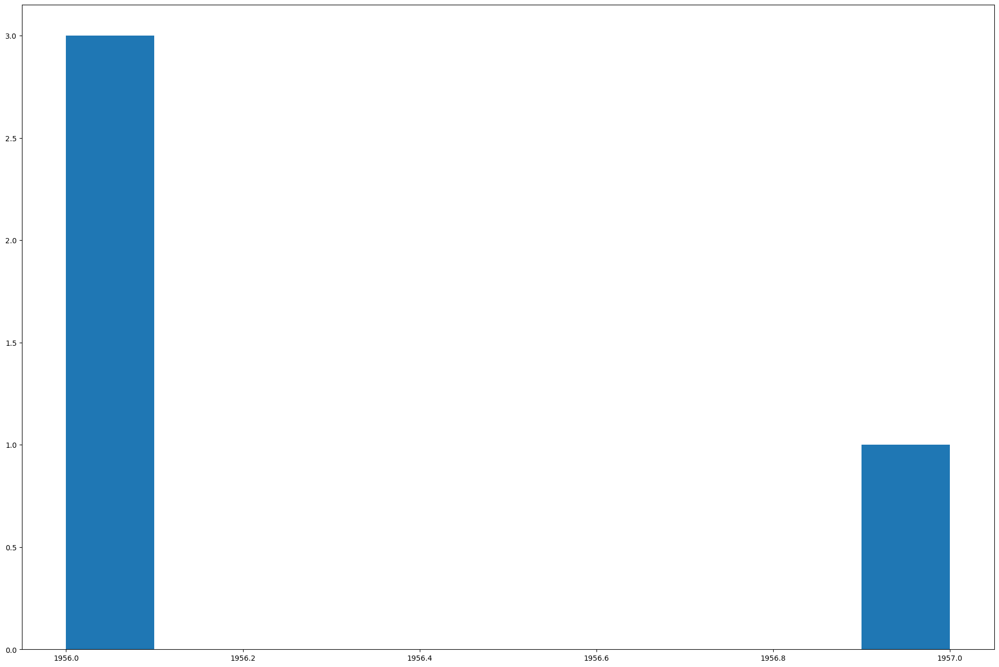

In [34]:
plt.hist(user_tagged_artists["year"][user_tagged_artists["year"] < 1970]);

The timestamp is relative to the amount of time that has pased since January 1st, 1970 00:00:00 UTC.   
These values occoured prior to that date so they return a negative value.  
I would consider any entrees older the start of 2000 to be errors so I will drop them

In [198]:
# I will drop all rows with a null value in the datetime column.
user_tagged_artists_ts = user_tagged_artists_ts.dropna(subset=["datetime"]).reset_index(drop=True)

# I will remove any data older than the year 1970

user_tagged_artists = user_tagged_artists[user_tagged_artists["year"] >= 2000].reset_index(drop=True)

I think it clear that the timestamp may not refer to what I initial thought it meant, I was hoping that the timestamp would provide more information on users listen pattern in relation to the time of day but since most of the data has the date time hour of 22 or 23 and some hours are missing I do not believe that I could derive users listening patterns in the way I hope, for this reason I will instead use the df  user_tagged_artists and delete the df user_tagged_artists_ts

In [36]:
user_tagged_artists.head()

,userID,artistID,tagID,day,month,year
0,2,52,13,1,4,2009
1,2,52,15,1,4,2009
2,2,52,18,1,4,2009
3,2,52,21,1,4,2009
4,2,52,41,1,4,2009


In [37]:
user_tagged_artists.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186475 entries, 0 to 186474
Data columns (total 6 columns):
 #   Column    Non-Null Count   Dtype
---  ------    --------------   -----
 0   userID    186475 non-null  int64
 1   artistID  186475 non-null  int64
 2   tagID     186475 non-null  int64
 3   day       186475 non-null  int64
 4   month     186475 non-null  int64
 5   year      186475 non-null  int64
dtypes: int64(6)
memory usage: 8.5 MB


In [38]:
user_tagged_artists.describe()

,userID,artistID,tagID,day,month,year
count,186475.000000,186475.000000,186475.000000,186475.000000,186475.000000,186475.000000
mean,1035.604204,4375.898732,1439.551388,1.095568,6.524210,2008.810918
std,622.457411,4897.827660,2775.295276,0.712821,3.486873,1.388903
min,2.000000,1.000000,1.000000,1.000000,1.000000,1979.000000
25%,488.000000,686.000000,79.000000,1.000000,3.000000,2008.000000
50%,1021.000000,2203.000000,195.000000,1.000000,7.000000,2009.000000
75%,1624.000000,6714.000000,887.000000,1.000000,10.000000,2010.000000
max,2100.000000,18744.000000,12647.000000,9.000000,12.000000,2011.000000


Since there isn't a difference in data values for user_tagged_artists and user_tagged_artists_ts I from this point onwards I will only be continuing with user_tagged_artists.

### Remove unneeded ids

In [39]:
artists

,artistID,name
0,1,MALICE MIZER
1,2,Diary of Dreams
2,3,Carpathian Forest
3,4,Moi dix Mois
4,5,Bella Morte
...,...,...
17627,18741,Diamanda Galás
17628,18742,Aya RL
17629,18743,Coptic Rain
17630,18744,Oz Alchemist


In [40]:
def check_ids(user_tagged_artists,user_artists,tags, artists):
    only_in_user_tagged_artists_a =  set(user_tagged_artists["artistID"]) - set(artists["artistID"])
    only_in_user_artists_a = set(artists["artistID"]) - set(user_tagged_artists["artistID"])

    print(f"There are {len(only_in_user_tagged_artists_a)} artists found in the df user_tagged_artists which aren't in artists \nand {len(only_in_user_artists_a)} artists only found in artists")

    only_in_user_tagged_artists_u = set(user_tagged_artists["userID"]) - set(user_artists["userID"])
    only_in_user_artists_u = set(user_artists["userID"]) - set(user_tagged_artists["userID"])

    print(f"There are {len(only_in_user_tagged_artists_u)} users found in the df user_tagged_artists which aren't in user_artists \nand {len(only_in_user_artists_u)} users only found in user_artists")
    
    only_in_user_tagged_artists_t = set(user_tagged_artists["tagID"]) - set(tags["tagID"])
    only_in_user_artists_t = set(tags["tagID"]) - set(user_tagged_artists["tagID"])

    print(f"There are {len(only_in_user_tagged_artists_t)} tags found in the df user_tagged_artists which aren't in tags \nand {len(only_in_user_artists_t)} tags only found in tags")

In [41]:
check_ids(user_tagged_artists, user_artists, tags, artists)

There are 390 artists found in the df user_tagged_artists which aren't in artists 
and 5499 artists only found in artists
There are 0 users found in the df user_tagged_artists which aren't in user_artists 
and 0 users only found in user_artists
There are 0 tags found in the df user_tagged_artists which aren't in tags 
and 2198 tags only found in tags


I will need to remove some IDs from multiple dfs.

1. I will delete the 390 artists which are not found in the artists df since I have no way in finding out who the artist is.
2. There are 5499 artists which appear in the user_artists df but none of the users have listened to in user_tagged_artists.
3. There are 2198 tags which appear in the tags df but have not been used in user_tagged_artists.

I will need to drop rows in user_tagged_artists df on artistID column.   
I will need to drop rows in tags df on tagID column.

I may drop unused artists at the end.

In [42]:
artistID_intersect = set(artists["artistID"].values).intersection(set(user_tagged_artists["artistID"].values))
print(len(artistID_intersect))

tagID_intersect = set(tags["tagID"].values).intersection(set(user_tagged_artists["tagID"].values))
print(len(tagID_intersect))

12133
9748


In [43]:
user_tagged_artists = user_tagged_artists.set_index("artistID").loc[list(artistID_intersect)].reset_index()

In [44]:
tags = tags.set_index("tagID").loc[list(tagID_intersect)].reset_index()

In [45]:
check_ids(user_tagged_artists, user_artists, tags, artists)

There are 0 artists found in the df user_tagged_artists which aren't in artists 
and 5499 artists only found in artists
There are 0 users found in the df user_tagged_artists which aren't in user_artists 
and 1 users only found in user_artists
There are 0 tags found in the df user_tagged_artists which aren't in tags 
and 31 tags only found in tags


It looks like a user may have exclusively listened to artists which are not found in the artists df.
I will remove this artist. I suspect that tags didn't drop to 0 becuase I delete rows in user_tagged_artists which created a new difference between the dfs.  
To fix this I will remove the one user and remove the extra tags.

In [46]:
tagID_intersect = set(tags["tagID"].values).intersection(set(user_tagged_artists["tagID"].values))
print(len(tagID_intersect))

tags = tags.set_index("tagID").loc[list(tagID_intersect)].reset_index()

9717


In [47]:
userID_intersect = set(user_artists["userID"].values).intersection(set(user_tagged_artists["userID"].values))
print(len(userID_intersect))

user_artists = user_artists.set_index("userID").loc[list(userID_intersect)].reset_index()

user_friends = user_friends.set_index("userID").loc[list(userID_intersect)].reset_index()
user_friends = user_friends.set_index("friendID").loc[list(userID_intersect)].reset_index()

1891


In [48]:
check_ids(user_tagged_artists, user_artists, tags, artists)

There are 0 artists found in the df user_tagged_artists which aren't in artists 
and 5499 artists only found in artists
There are 0 users found in the df user_tagged_artists which aren't in user_artists 
and 0 users only found in user_artists
There are 0 tags found in the df user_tagged_artists which aren't in tags 
and 0 tags only found in tags


In [49]:
sorted(set(user_friends["userID"])) == sorted(set(user_friends["friendID"])) == sorted(set(user_artists["userID"])) == sorted(set(user_tagged_artists["userID"]))

True

As you can see that all the values are at 0 apart from artists which has 5499 extra artists which do not appare in the user_tagged_artists df.  
I will explore wether to delete or keeps these values at the end.

### extra_artist_data.csv

Novel dataset which I created by scraping the last.fm website.  
The webscraper Python script can be found in the file ...

I used the url found in the orginal artists df.  
I then scraped the following data Time, this usually represented the years the artist was actively making music but sometimes return birth year instead.  
I then found three similar artists.

In [50]:
extra_artist_data = artists.join(pd.read_csv("data/extra_artist_data.csv", index_col = ["Unnamed: 0"]))

In [51]:
extra_artist_data.describe(include=[object])

,name,Time,Sim1,Sim2,Sim3
count,17632,11433,17303,17286,17270
unique,17632,5073,13364,13147,13154
top,MALICE MIZER,2004 – present (18 years),The Funky Lowlives,Nuspirit Helsinki,The Mighty Bop
freq,1,254,14,12,14


In [52]:
extra_artist_data.head()

,artistID,name,Time,Sim1,Sim2,Sim3
0,1,MALICE MIZER,1992 – 2001 (9 years),Moi dix Mois,LAREINE,Közi
1,2,Diary of Dreams,1989 – present (33 years),Diorama,L'Âme Immortelle,Deine Lakaien
2,3,Carpathian Forest,1990 – present (32 years),Nattefrost,Gorgoroth,Urgehal
3,4,Moi dix Mois,2002 – present (20 years),MALICE MIZER,Közi,LAREINE
4,5,Bella Morte,1996 – present (26 years),The Crüxshadows,Seraphim Shock,The Last Dance


In [53]:
# Find the years the artists were active
def get_year(x, which):
    try:
        years = x.split("–")
        if len(years) == 2:
            if which == "start":
                return years[0].strip()
            elif  which == "end":
                return years[1].split("(")[0].strip()
        else:
            return np.nan
    except AttributeError:
        return np.nan

In [54]:
extra_artist_data["start_year"] = extra_artist_data["Time"].apply(lambda x, result_type="broadcast": get_year(x, which="start"))
extra_artist_data["end_year"] = extra_artist_data["Time"].apply(lambda x, result_type="broadcast": get_year(x, which="end"))

In [55]:
extra_artist_data[["start_year", "end_year"]].replace({"present":"2022"},inplace=True)

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\3930787286.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  extra_artist_data[["start_year", "end_year"]].replace({"present":"2022"},inplace=True)


In [56]:
len(extra_artist_data.dropna(subset="start_year")) / len(extra_artist_data)

0.3577019056261343

If I was to drop all rows where there wasn't a start year found I would lose ~ 65% of the data.  
For this reason I will remove the all the time related columns.

In [57]:
drop_columns = ["Time", "start_year", "end_year"]
try:
    extra_artist_data.drop(columns=drop_columns, inplace=True)
except KeyError:
    for colName in drop_columns:
        try:
            extra_artist_data.drop(columns=colName, inplace=True)
        except KeyError:
            pass

In [58]:
artists == extra_artist_data[["artistID","name"]]

,artistID,name
0,True,True
1,True,True
2,True,True
3,True,True
4,True,True
...,...,...
17627,True,True
17628,True,True
17629,True,True
17630,True,True


dfs are the same, but the df extra_artist_data contains extra data.  
I will now try to convert the artists names in the sim{i} columns into their id representation.  
I suspect that some will have not appeared before so I wil have to give them a new id starting at 18746

In [59]:
artistid_name_dict = extra_artist_data.set_index("name")["artistID"].to_dict()
extra_artist_data[["Sim1","Sim2","Sim3"]].replace(artistid_name_dict)

,Sim1,Sim2,Sim3
0,4,12702,Közi
1,3191,3184,4872
2,Nattefrost,28,8343
3,1,Közi,12702
4,18,Seraphim Shock,18442
...,...,...,...
17627,10812,5420,Meredith Monk
17628,865,Klaus Mitffoch,15478
17629,Think About Mutation,DKay.com,Unit:187
17630,Practicum,minimum republic,Starek


The artist Közi does not have an ID so I will assign one to them.

In [60]:
def convert_to_id(extra_artist_data):
    artistid_name_dict = extra_artist_data.set_index("name")["artistID"].to_dict()
    extra_artist_data[["Sim1","Sim2","Sim3"]] = extra_artist_data[["Sim1","Sim2","Sim3"]].replace(artistid_name_dict)
    artistid_counter = 18746
    
    for i, row in enumerate(extra_artist_data[["Sim1","Sim2","Sim3"]].values):
        for artistName in row:
            try:
                int(artistName)
            except ValueError:
                sim_artists = pd.DataFrame(
                extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
                extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
                extra_artist_data[extra_artist_data["Sim3"] == artistName][["artistID","Sim1","Sim2"]]
                ).values.flatten()).value_counts().head(3).index.values
                
                sim_artists_list = [x[0] for x in sim_artists]
                while len(sim_artists_list) < 3:
                    sim_artists_list.append(np.nan)
                
                new_row = {"artistID":artistid_counter,
                           "name":artistName,
                           "Sim1":sim_artists_list[0],
                           "Sim2":sim_artists_list[1],
                           "Sim3":sim_artists_list[2]}
                
                extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
                artistid_counter += 1
    artistid_name_dict = extra_artist_data.set_index("name")["artistID"].to_dict()
    extra_artist_data[["Sim1","Sim2","Sim3"]] = extra_artist_data[["Sim1","Sim2","Sim3"]].replace(artistid_name_dict)
    extra_artist_data[["artistID","Sim1","Sim2","Sim3"]] = extra_artist_data[["artistID","Sim1","Sim2","Sim3"]].astype(int)
    return extra_artist_data

In [61]:
extra_artist_data_updated = convert_to_id(extra_artist_data)

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim1"] == artistName][["artistID","Sim2","Sim3"]].append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data[extra_artist_data["Sim2"] == artistName][["artistID","Sim1","Sim3"]]).append(
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:27: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  extra_artist_data = extra_artist_data.append(new_row,ignore_index=True)
C:\Users\PC\AppData\Local\Temp\ipykernel_4484\1211579400.py:12: FutureWarning: The frame.append method is deprecated and will be removed fro

In [62]:
extra_artist_data_updated

,artistID,name,Sim1,Sim2,Sim3
0,1,MALICE MIZER,4,12702,18748
1,2,Diary of Dreams,3191,3184,4872
2,3,Carpathian Forest,18747,28,8343
3,4,Moi dix Mois,1,18748,12702
4,5,Bella Morte,18,18749,18442
...,...,...,...,...,...
46573,47687,minimum republic,18744,47688,47686
46574,47688,Starek,18744,2557,47686
46575,47689,Dagmara Korona-Persowska,18745,8289,29606
46576,47690,Tomasz Wachnowski,18745,47689,47691


In [63]:
len(extra_artist_data_updated) / len(artists)

2.6416742286751362

By including the new artists found in the sim columns the number of artists increased by more than 150%.  
I am not yet sure what impact this will have.   

DataFrames that I will keep are:
1. extra_artist_data_updated
2. user_friends
3. tags
4. user_tagged_artists

In the next section I will look further into the tags and user_tagged_artists[tagID]

### Tags Part 2

In [64]:
user_tagged_artists[["tagID"]].describe()

,tagID
count,184937.000000
mean,1439.518506
std,2775.309948
min,1.000000
25%,79.000000
50%,195.000000
75%,885.000000
max,12647.000000


In [65]:
user_tagged_artists["tagID"].value_counts()

73       7459
24       5401
79       5223
18       4616
81       4422
         ... 
11244       1
11243       1
7310        1
7309        1
11861       1
Name: tagID, Length: 9717, dtype: int64

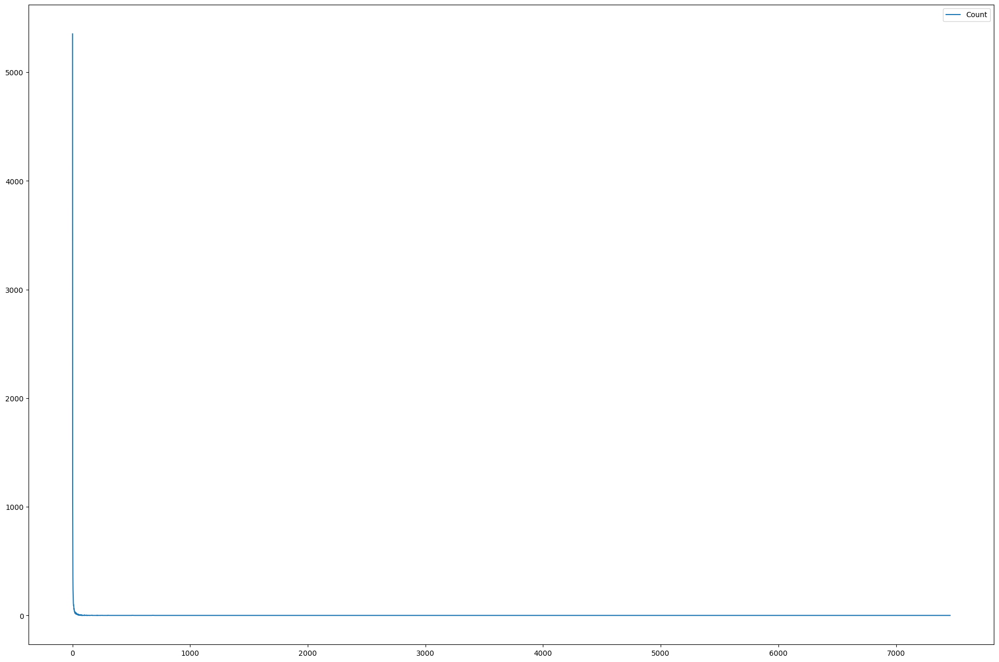

In [66]:
sns.lineplot(pd.DataFrame(user_tagged_artists["tagID"].value_counts().value_counts()).rename(columns={"tagID":"Count"}));

The graph above plots the count of how many times a tag is used, as you can see a majority of tags are used only a few times.

In [67]:
len(
    user_tagged_artists["tagID"].value_counts(
    )[user_tagged_artists["tagID"].value_counts() == 1]
    ) / len(
    user_tagged_artists["tagID"].value_counts())

0.5508901924462283

55% of the tags only occur onces, I assume that there are a large number of tags which don't provide much useful information.
I will work on removing some of these tags, starting with once which rarely occur.

In [68]:
len(
    user_tagged_artists["tagID"].value_counts(
    )[user_tagged_artists["tagID"].value_counts() <= 20]
    ) / len(
    user_tagged_artists["tagID"].value_counts())

0.910980755377174

91% of the tags only occur 10 or less times.

In [69]:
for tagID in user_tagged_artists["tagID"].value_counts(
    )[user_tagged_artists["tagID"].value_counts() <= 20].head().index:
    print(tags[tags["tagID"] ==tagID].values)
    print(user_tagged_artists[user_tagged_artists["tagID"] ==tagID][["artistID","userID"]].nunique())

[[537 'neofolk']]
artistID    17
userID       9
dtype: int64
[[3926 'psicodelia']]
artistID    20
userID       2
dtype: int64
[[4923 "1980's"]]
artistID    20
userID       1
dtype: int64
[[1030 '1986']]
artistID    20
userID       3
dtype: int64
[[9433 'in the chillwave family']]
artistID    20
userID       1
dtype: int64


I picked 5 tagIDs which had been used exactly 10 times in the df.  
As you can see from the tagValues = ["no genre can describe"..."outsiders"]
Aren't very informative without applying something like npl on the text.

Some tags are commonly used by a small number of users.

<AxesSubplot: ylabel='Count'>

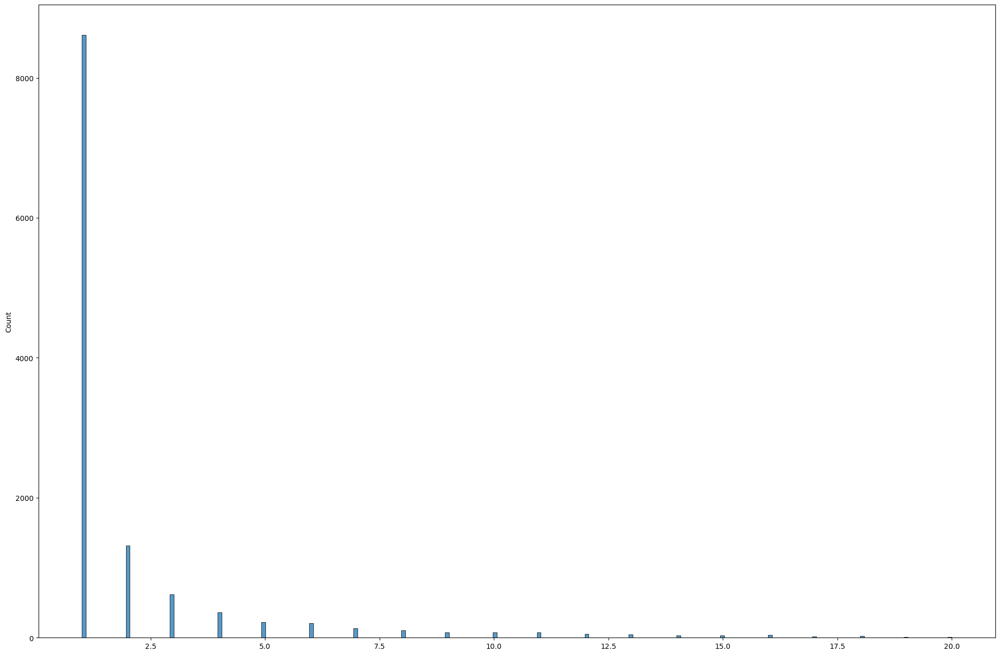

In [70]:
sns.histplot(
    user_tagged_artists.set_index("tagID"
    ).loc[user_tagged_artists["tagID"].value_counts(
    )[user_tagged_artists["tagID"].value_counts(
    ) <= 20].index].reset_index().rename(
    columns={"index":"tagID"}
    )[["tagID","userID"]].value_counts().values)

<AxesSubplot: ylabel='Count'>

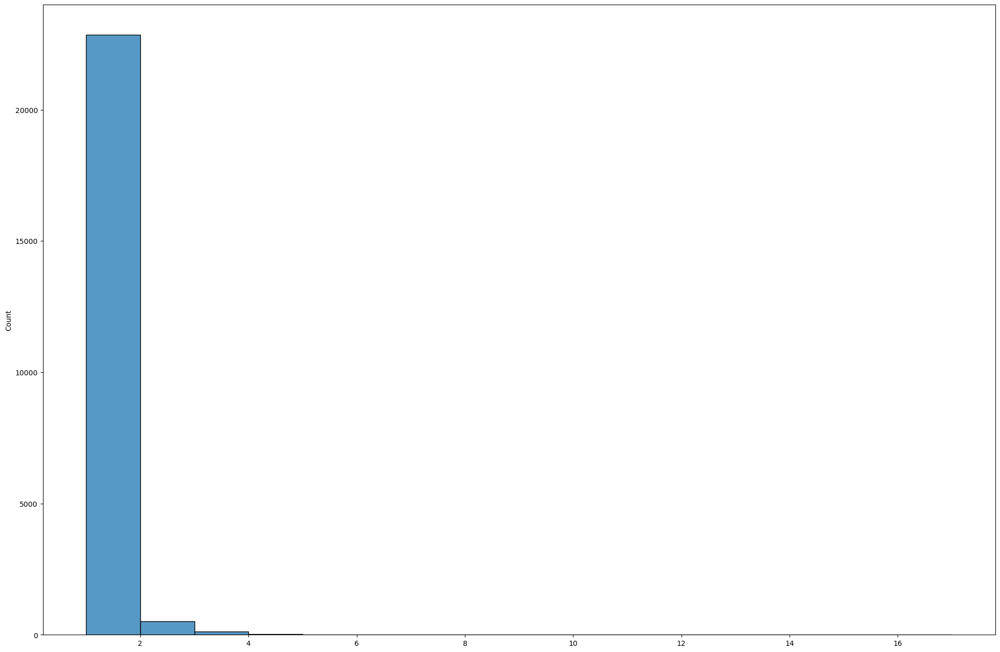

In [71]:
sns.histplot(
    user_tagged_artists.set_index("tagID"
    ).loc[user_tagged_artists["tagID"].value_counts(
    )[user_tagged_artists["tagID"].value_counts(
    ) <= 20].index].reset_index().rename(
    columns={"index":"tagID"}
    )[["tagID","artistID"]].value_counts())

In [72]:
user_tagged_artists["artistID"].value_counts()[user_tagged_artists["artistID"].value_counts() < 10]

2756     9
5555     9
5715     9
7316     9
1931     9
        ..
10841    1
10842    1
15802    1
15796    1
3692     1
Name: artistID, Length: 7756, dtype: int64

In [73]:
user_tagged_artists.set_index("artistID"
    ).loc[user_tagged_artists["artistID"].value_counts(
    )[user_tagged_artists["artistID"].value_counts(
    ) <= 10].index].reset_index().rename(
    columns={"index":"artistID"}
    )[["artistID", "userID"]].value_counts()

artistID  userID
12453     1854      10
6898      439       10
9656      1234      10
12476     1121      10
9333      695       10
                    ..
7741      1547       1
          1689       1
7742      1004       1
7745      1470       1
18741     1946       1
Length: 16694, dtype: int64

In [74]:
artists_tag_ptable = pd.DataFrame(
    user_tagged_artists[["artistID", "tagID"]].value_counts()
    ).pivot_table(index="artistID", columns=["tagID"])

In [75]:
top_five = {
    "artistID":[],
}

for i in range(1,6):
    top_five[f"tagID_0{i}"] = []
    top_five[f"count_0{i}"] = []

for artistID in user_tagged_artists["artistID"].unique():
    top_five["artistID"].append(artistID)
    
    temp_df = pd.DataFrame(
    user_tagged_artists[user_tagged_artists["artistID"] == artistID][["tagID","artistID"]].value_counts(
    ).head())
    tagID_values = temp_df.index.get_level_values(0).tolist()    
    counts = temp_df.values.flatten().tolist()
    
    while len(counts) < 5:
        tagID_values.append(np.nan)
        counts.append(np.nan)
    for i in range(0,5):
        top_five[f"tagID_0{i+1}"].append(tagID_values[i])
        top_five[f"count_0{i+1}"].append(counts[i])

In [76]:
top_fiv_df = pd.DataFrame(top_five).set_index("artistID").sort_values(by="count_01", ascending=False)

<AxesSubplot: xlabel='weight', ylabel='Count'>

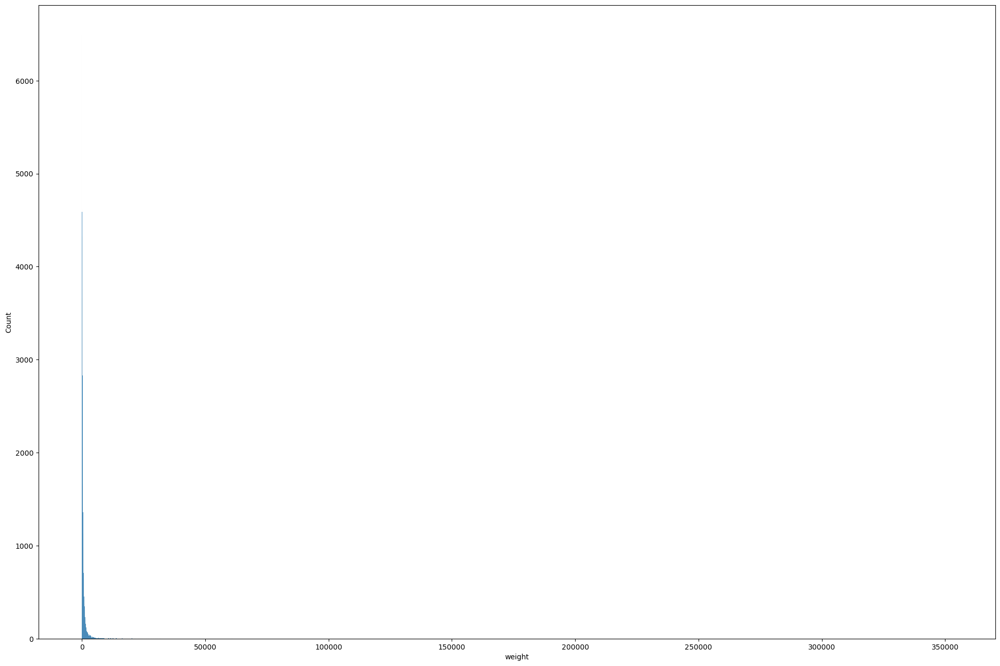

In [77]:
sns.histplot(user_artists["weight"])

In [155]:
artists_tags_to_keep = top_fiv_df.dropna(axis=0, thresh=6).index.tolist()

In [145]:
top_fiv_df[top_fiv_df["count_01"] <= 2]

,tagID_01,count_01,tagID_02,count_02,tagID_03,count_03,tagID_04,count_04,tagID_05,count_05
artistID,,,,,,,,,,
7822,73,2,79.0,2.0,84.0,2.0,81.0,1.0,216.0,1.0
7799,387,2,424.0,2.0,432.0,2.0,73.0,1.0,192.0,1.0
15269,1356,2,213.0,1.0,216.0,1.0,306.0,1.0,625.0,1.0
17752,14,2,364.0,1.0,12094.0,1.0,NaN,NaN,NaN,NaN
6694,103,2,102.0,1.0,304.0,1.0,3544.0,1.0,12287.0,1.0
...,...,...,...,...,...,...,...,...,...,...
10408,1684,1,1845.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
4190,81,1,5452.0,1.0,11878.0,1.0,NaN,NaN,NaN,NaN
10405,1684,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [87]:
artists_tags_to_keep_dict = {}
for artistID in artists_tags_to_keep:
    artists_tags_to_keep_dict[artistID] = {
        "tag1":top_fiv_df.loc[artistID]["tagID_01"],
        "tag2":top_fiv_df.loc[artistID]["tagID_02"],
        "tag3":top_fiv_df.loc[artistID]["tagID_03"],}

In [98]:
user_tagged_artists

,artistID,userID,tagID,day,month,year
0,1,37,552,1,7,2008
1,1,274,1219,1,5,2008
2,1,681,139,1,8,2008
3,1,681,141,1,8,2008
4,1,785,2850,1,8,2010
...,...,...,...,...,...,...
184932,18744,454,2525,1,10,2009
184933,18744,454,3081,1,5,2010
184934,18744,454,3660,1,10,2009
184935,18744,454,3666,1,6,2009


In [144]:
artists_top_tags = pd.DataFrame(
    artists_tags_to_keep_dict).T.astype(
    int).reset_index().rename(
    columns={"index":"artistID"}
    ).sort_values(by="artistID").reset_index(
    drop=True)

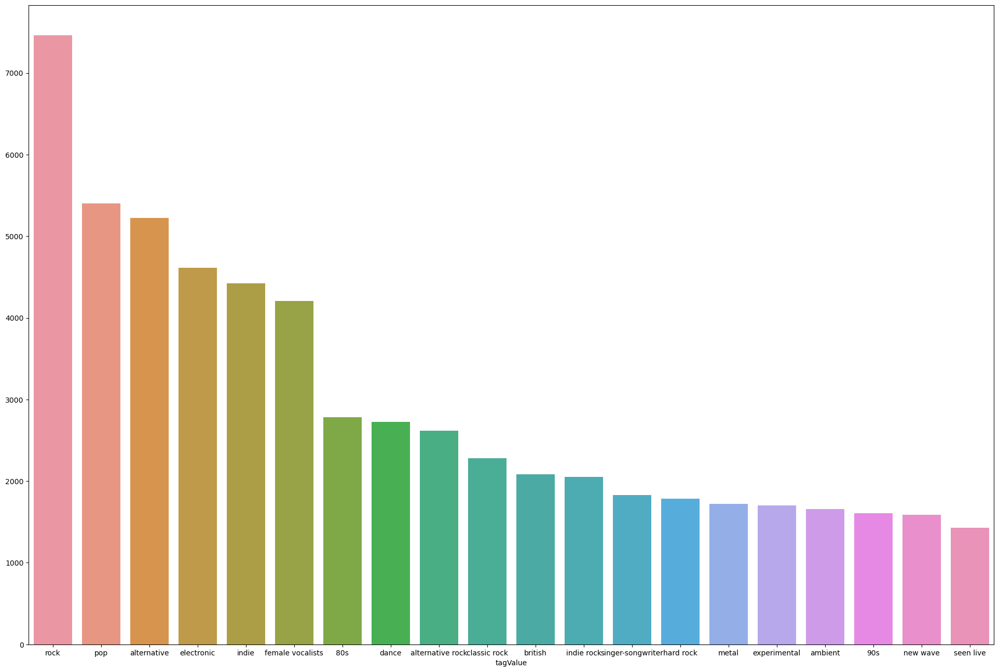

In [83]:
sns.barplot(top_tags.set_index("tagValue").T);

In [176]:
extra_artist_data_updated

,artistID,name,Sim1,Sim2,Sim3
0,1,MALICE MIZER,4,12702,18748
1,2,Diary of Dreams,3191,3184,4872
2,3,Carpathian Forest,18747,28,8343
3,4,Moi dix Mois,1,18748,12702
4,5,Bella Morte,18,18749,18442
...,...,...,...,...,...
46573,47687,minimum republic,18744,47688,47686
46574,47688,Starek,18744,2557,47686
46575,47689,Dagmara Korona-Persowska,18745,8289,29606
46576,47690,Tomasz Wachnowski,18745,47689,47691


Somethings that I learned from analysing the tags is that mnay artists tags don't reveal to much information about them.
I am considering scraping the top tags from the last.fm website and using them instead. 

### Final section export data to processed data file.

The data that I will be taking to the next part of my work is.

1. Artists. To have the ability to lookup a artists name from their id.
2. Tags for the same reason above.
3. I will the extra_artist_data_updated but rename to similar_artist.
4. I will continue to explore user_tagged_artists as I want to learn if there is a seaonal pattern to some tags/artists.
5. I also need to explore the relationships in user_artists and user_friends.

count    184936.000000
mean          1.095963
std           0.714018
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           9.000000
Name: day, dtype: float64


(array([181418.,      0.,      0.,      0.,      0.,   1499.,   1467.,
             0.,      0.,    552.]),
 array([1. , 1.8, 2.6, 3.4, 4.2, 5. , 5.8, 6.6, 7.4, 8.2, 9. ]),
 <BarContainer object of 10 artists>)

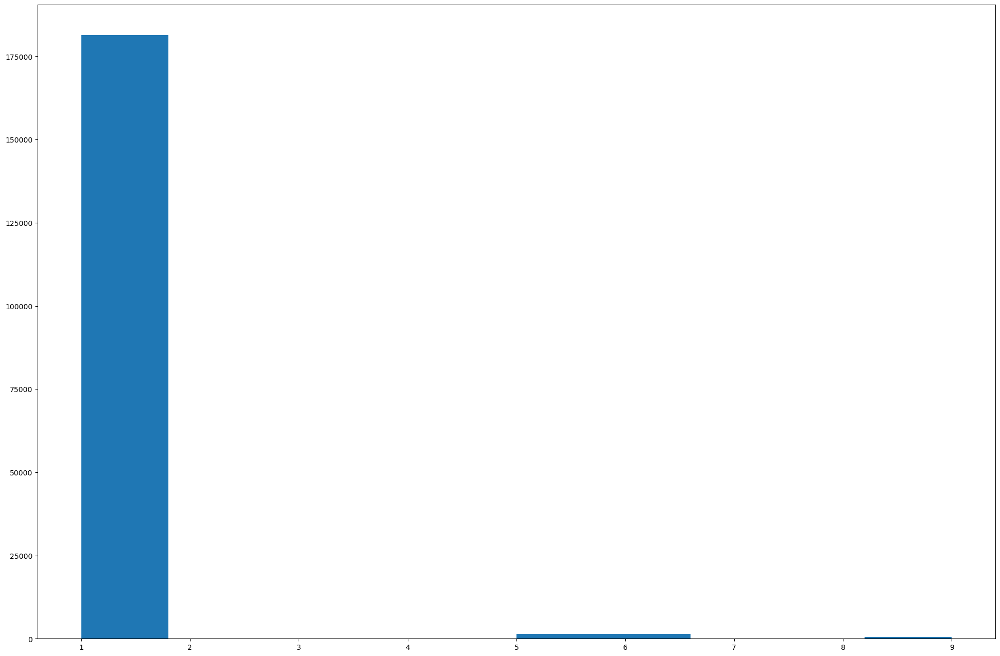

In [202]:
print(user_tagged_artists["day"].describe())
plt.hist(user_tagged_artists["day"])

count    184936.000000
mean          6.522538
std           3.486696
min           1.000000
25%           3.000000
50%           7.000000
75%          10.000000
max          12.000000
Name: month, dtype: float64


(array([30481., 17350., 12968., 18237., 12353., 15232., 16050., 13527.,
        16340., 32398.]),
 array([ 1. ,  2.1,  3.2,  4.3,  5.4,  6.5,  7.6,  8.7,  9.8, 10.9, 12. ]),
 <BarContainer object of 10 artists>)

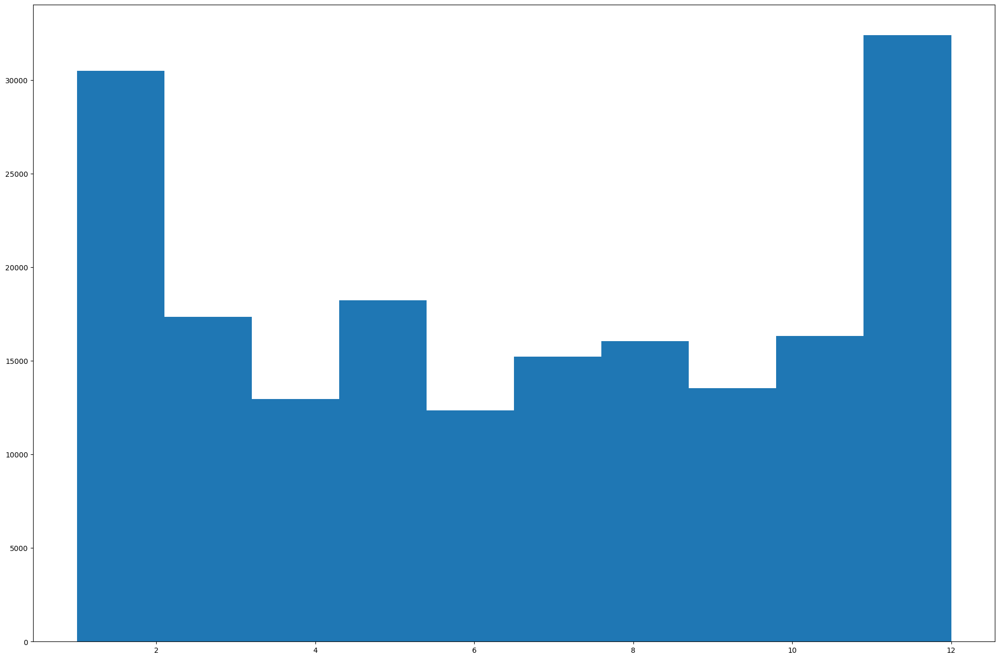

In [203]:
print(user_tagged_artists["month"].describe())
plt.hist(user_tagged_artists["month"])

It is clear that day doesn't refer to the day the user listened the music since over 75% of the data is concertated on the first of every month. While there is a more believeable distribution of values for months.
I will drop the day value.

In [205]:
path = "data/processed_data/"

updated_artists_IDs = extra_artist_data_updated[["artistID","name"]]
updated_artists_IDs.to_csv(f"{path}artist.csv",index=False)

extra_artist_data_updated.drop(columns=["name"]).to_csv(f"{path}similar_artist.csv",index=False)

user_tagged_artists.drop(columns=["day"]).to_csv(f"{path}atu_relationship.csv",index=False)